In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import plotly.express as px
import seaborn as sns
sns.set()
from sklearn.preprocessing import OrdinalEncoder,LabelEncoder
from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from xgboost import XGBClassifier
import shap
from sklearn.model_selection import train_test_split
from imblearn.over_sampling import SMOTE
from sklearn.metrics import classification_report, confusion_matrix, roc_auc_score, accuracy_score, f1_score
from sklearn.metrics import recall_score
import warnings
warnings.filterwarnings("ignore")
pd.set_option('display.max_rows', 1000)
from joblib import dump,load

In [2]:
# Load the dataset
data = pd.read_csv('https://github.com/navyajain269/Capstone/raw/main/CVD_cleaned.csv')
data.head()

,General_Health,Checkup,Exercise,Heart_Disease,Skin_Cancer,Other_Cancer,Depression,Diabetes,Arthritis,Sex,Age_Category,Height_(cm),Weight_(kg),BMI,Smoking_History,Alcohol_Consumption,Fruit_Consumption,Green_Vegetables_Consumption,FriedPotato_Consumption
0,Poor,Within the past 2 years,No,No,No,No,No,No,Yes,Female,70-74,150.0,32.66,14.54,Yes,0.0,30.0,16.0,12.0
1,Very Good,Within the past year,No,Yes,No,No,No,Yes,No,Female,70-74,165.0,77.11,28.29,No,0.0,30.0,0.0,4.0
2,Very Good,Within the past year,Yes,No,No,No,No,Yes,No,Female,60-64,163.0,88.45,33.47,No,4.0,12.0,3.0,16.0
3,Poor,Within the past year,Yes,Yes,No,No,No,Yes,No,Male,75-79,180.0,93.44,28.73,No,0.0,30.0,30.0,8.0
4,Good,Within the past year,No,No,No,No,No,No,No,Male,80+,191.0,88.45,24.37,Yes,0.0,8.0,4.0,0.0


In [3]:
data.shape

(308854, 19)

In [4]:
data.dtypes

General_Health                   object
Checkup                          object
Exercise                         object
Heart_Disease                    object
Skin_Cancer                      object
Other_Cancer                     object
Depression                       object
Diabetes                         object
Arthritis                        object
Sex                              object
Age_Category                     object
Height_(cm)                     float64
Weight_(kg)                     float64
BMI                             float64
Smoking_History                  object
Alcohol_Consumption             float64
Fruit_Consumption               float64
Green_Vegetables_Consumption    float64
FriedPotato_Consumption         float64
dtype: object

In [5]:
data = data.drop_duplicates()

In [6]:
data.duplicated().sum()
data.shape

(308774, 19)

In [7]:
data.isnull().sum()

General_Health                  0
Checkup                         0
Exercise                        0
Heart_Disease                   0
Skin_Cancer                     0
Other_Cancer                    0
Depression                      0
Diabetes                        0
Arthritis                       0
Sex                             0
Age_Category                    0
Height_(cm)                     0
Weight_(kg)                     0
BMI                             0
Smoking_History                 0
Alcohol_Consumption             0
Fruit_Consumption               0
Green_Vegetables_Consumption    0
FriedPotato_Consumption         0
dtype: int64

In [8]:
#Descriptive statistics for numerical columns
data.describe().transpose()

,count,mean,std,min,25%,50%,75%,max
Height_(cm),308774.0,170.615220,10.658452,91.00,163.00,170.00,178.00,241.00
Weight_(kg),308774.0,83.590399,21.344664,24.95,68.04,81.65,95.25,293.02
BMI,308774.0,28.626813,6.522810,12.02,24.21,27.44,31.85,99.33
Alcohol_Consumption,308774.0,5.097557,8.200434,0.00,0.00,1.00,6.00,30.00
Fruit_Consumption,308774.0,29.834290,24.877812,0.00,12.00,30.00,30.00,120.00
Green_Vegetables_Consumption,308774.0,15.109517,14.926912,0.00,4.00,12.00,20.00,128.00
FriedPotato_Consumption,308774.0,6.297237,8.583837,0.00,2.00,4.00,8.00,128.00


In [9]:
data.select_dtypes(include=['object']).nunique()

General_Health      5
Checkup             5
Exercise            2
Heart_Disease       2
Skin_Cancer         2
Other_Cancer        2
Depression          2
Diabetes            4
Arthritis           2
Sex                 2
Age_Category       13
Smoking_History     2
dtype: int64

In [10]:
# With the help of for loop, we will now check if there are any typos in the categorical columns or not
for col in data.select_dtypes(include = "object"):
    print(f"Column name: {col}")
    print(data[col].unique())
    print('\n', '-'*80, '\n')

Column name: General_Health
['Poor' 'Very Good' 'Good' 'Fair' 'Excellent']

 -------------------------------------------------------------------------------- 

Column name: Checkup
['Within the past 2 years' 'Within the past year' '5 or more years ago'
 'Within the past 5 years' 'Never']

 -------------------------------------------------------------------------------- 

Column name: Exercise
['No' 'Yes']

 -------------------------------------------------------------------------------- 

Column name: Heart_Disease
['No' 'Yes']

 -------------------------------------------------------------------------------- 

Column name: Skin_Cancer
['No' 'Yes']

 -------------------------------------------------------------------------------- 

Column name: Other_Cancer
['No' 'Yes']

 -------------------------------------------------------------------------------- 

Column name: Depression
['No' 'Yes']

 -------------------------------------------------------------------------------- 

Column name:

In [11]:
diabetes_mapping = {
    'No': 'No',
    'No, pre-diabetes or borderline diabetes': 'No',
    'Yes, but female told only during pregnancy': 'Yes',
    'Yes': 'Yes'
}
data['Diabetes'] = data['Diabetes'].map(diabetes_mapping)

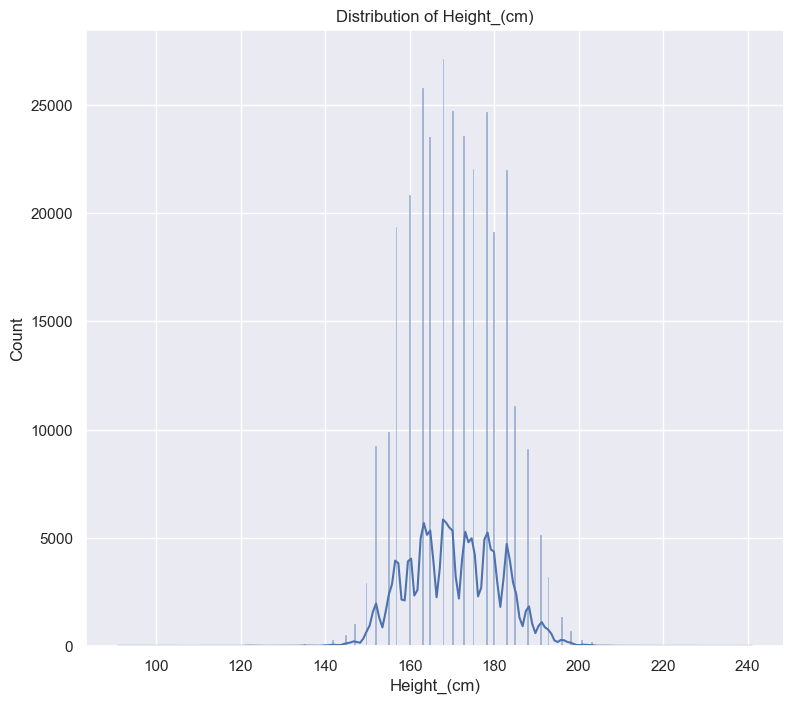

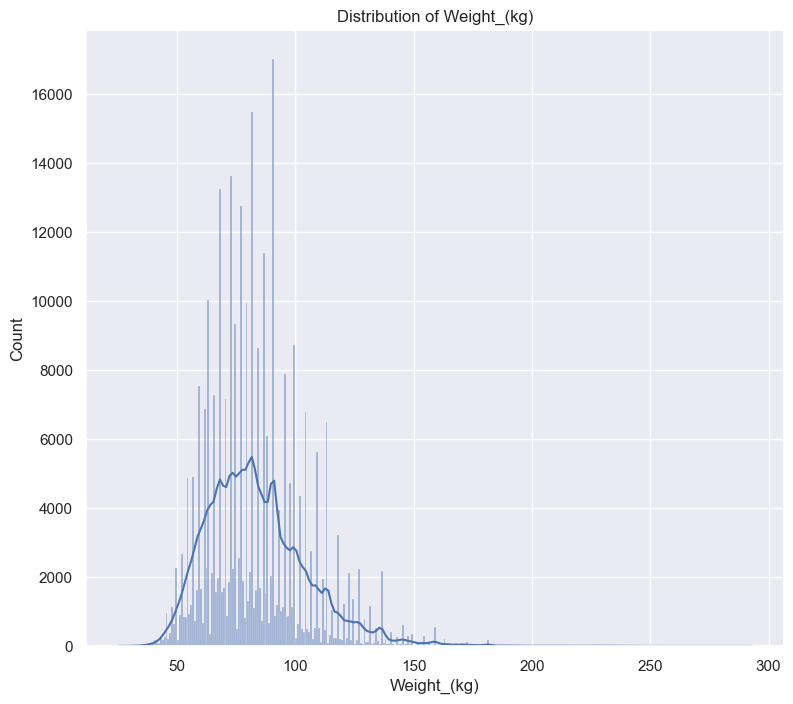

In [12]:
# Univariate Analysis
# Check the distribution of numerical features
numerical_features = ['Height_(cm)', 'Weight_(kg)']

for feature in numerical_features:
    plt.figure(figsize=(9, 8))
    sns.histplot(data=data, x=feature, kde=True)
    plt.title('Distribution of ' + feature)
    plt.show()

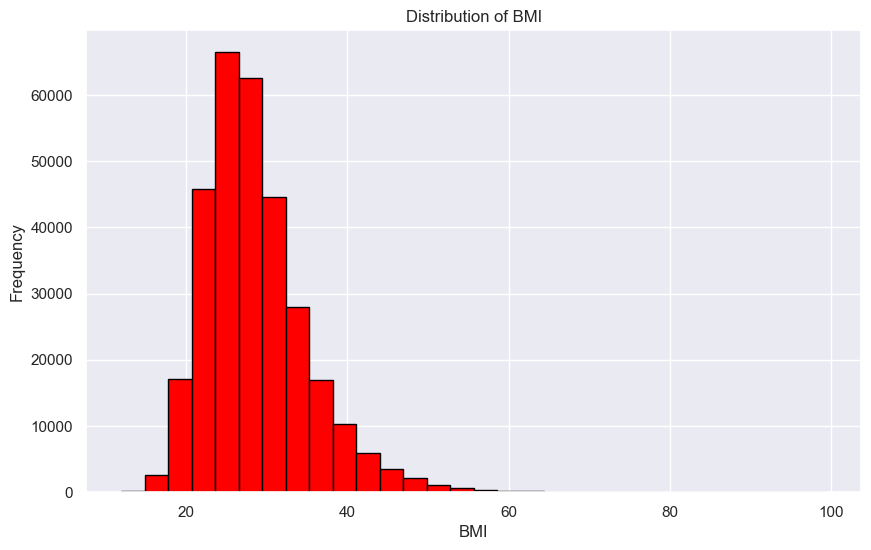

In [13]:
#histogram for BMI
plt.figure(figsize=(10, 6))
plt.hist(data['BMI'], bins=30, color='red', edgecolor='black')
plt.title('Distribution of BMI')
plt.xlabel('BMI')
plt.ylabel('Frequency')
plt.show()

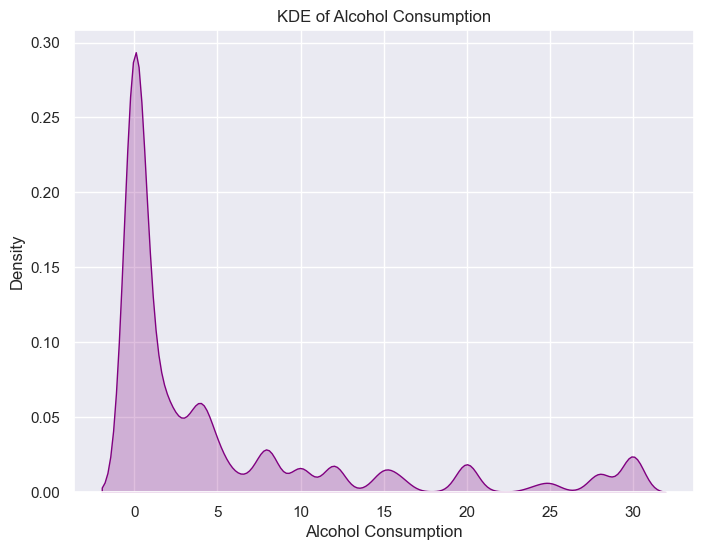

In [14]:
#Kernel Density Estimation (KDE) for Alcohol_Consumption:
plt.figure(figsize=(8, 6))
sns.kdeplot(data['Alcohol_Consumption'],fill=True, color='purple')
plt.title('KDE of Alcohol Consumption')
plt.xlabel('Alcohol Consumption')
plt.ylabel('Density')
plt.show()

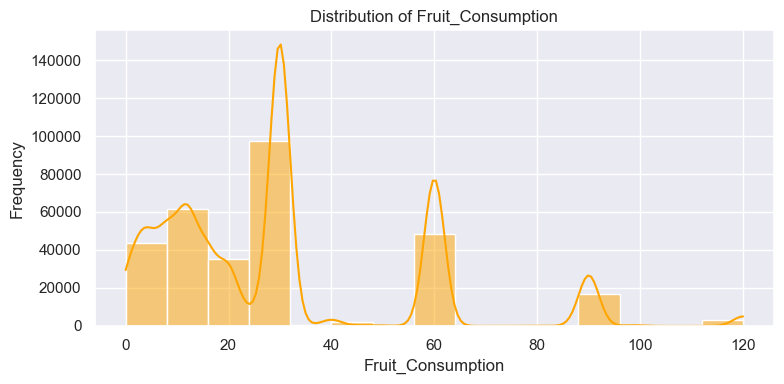

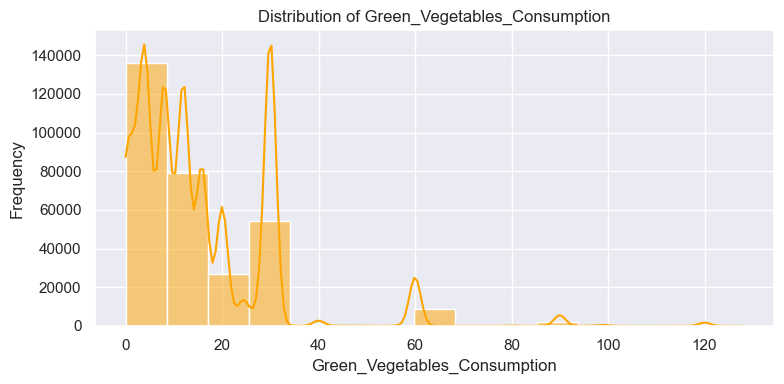

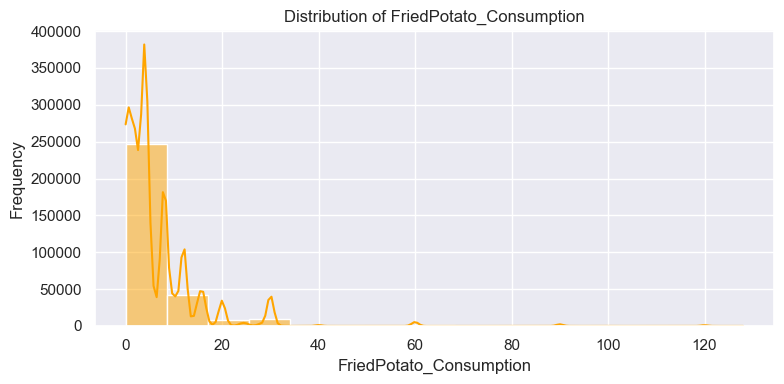

In [15]:
F= ['Fruit_Consumption', 'Green_Vegetables_Consumption', 'FriedPotato_Consumption']
# Perform univariate analysis for each variable
for variable in F:
    plt.figure(figsize=(8, 4))

    # Histogram
    #plt.subplot(1, 2, 1)
    sns.histplot(data=data, x=variable, kde=True, bins = 15,color="orange")
    plt.xlabel(variable)
    plt.ylabel("Frequency")
    plt.title("Distribution of "+variable)

    # Adjust spacing between subplots
    plt.tight_layout()

    # Show the plots
    plt.show()

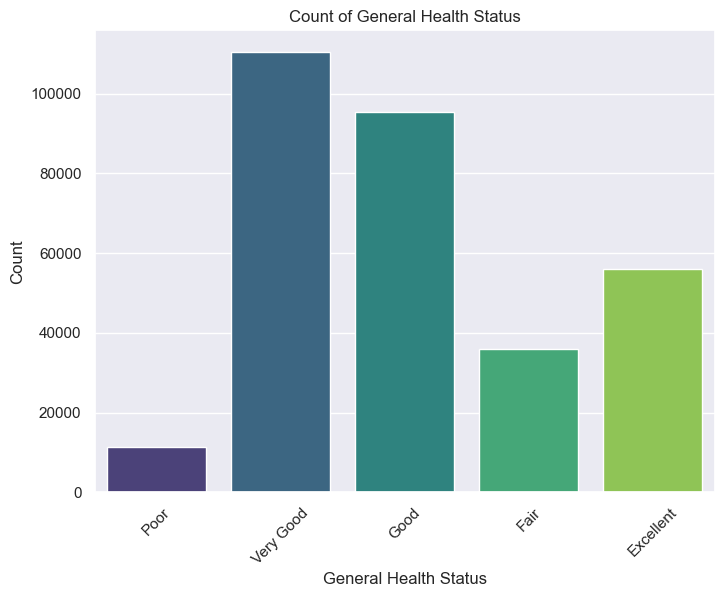

In [16]:
#Count plot for General_Health
plt.figure(figsize=(8, 6))
sns.countplot(data=data, x='General_Health', palette='viridis')
plt.title('Count of General Health Status')
plt.xlabel('General Health Status')
plt.ylabel('Count')
plt.xticks(rotation=45)
plt.show()

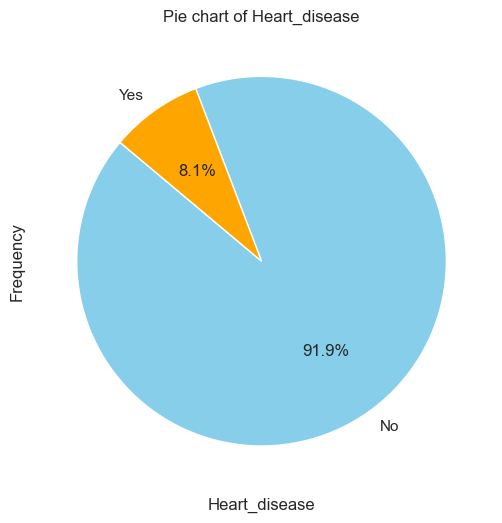

In [17]:
plt.figure(figsize=(10, 6))
binary_counts = data['Heart_Disease'].value_counts()
plt.pie(binary_counts, labels=binary_counts.index, autopct='%1.1f%%', startangle=140, colors=['skyblue', 'orange'])
plt.title(f'Pie chart of Heart_disease')
plt.xlabel('Heart_disease')
plt.ylabel('Frequency')
plt.grid(True)
plt.show()

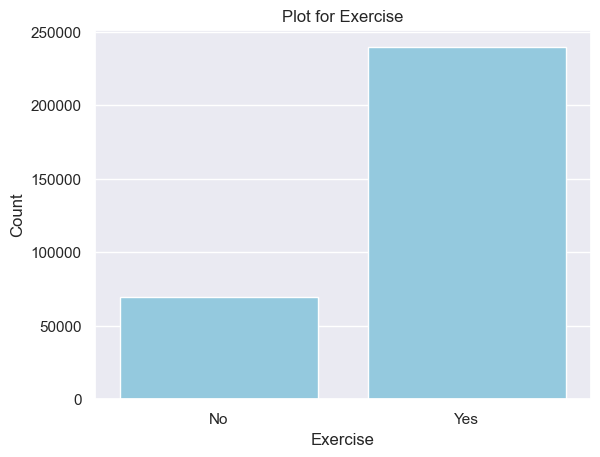

In [18]:
plot_color = 'skyblue'
sns.countplot(x=data['Exercise'], color=plot_color)

plt.title('Plot for Exercise')
plt.xlabel('Exercise')
plt.ylabel('Count')

# Show plot
plt.show()

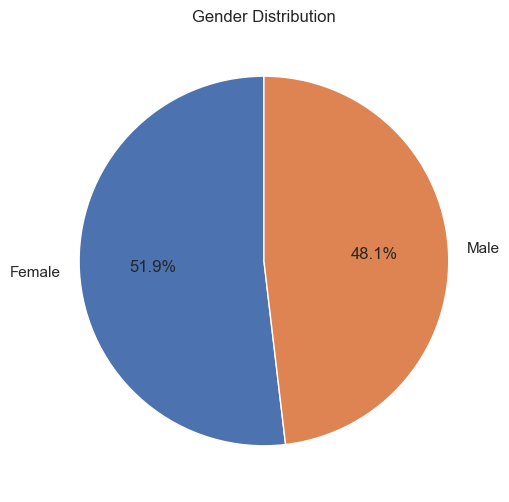

In [19]:
# Gender Pie Chart
gender_counts = data['Sex'].value_counts()
plt.figure(figsize=(6, 6))
gender_titles = {'Female': 'Female', 'Male': 'Male'}
plt.pie(gender_counts, labels=gender_counts.index, autopct='%1.1f%%', startangle=90)
plt.title('Gender Distribution')
plt.show()

Text(0.5, 1.0, 'Distribution of Arthritis')

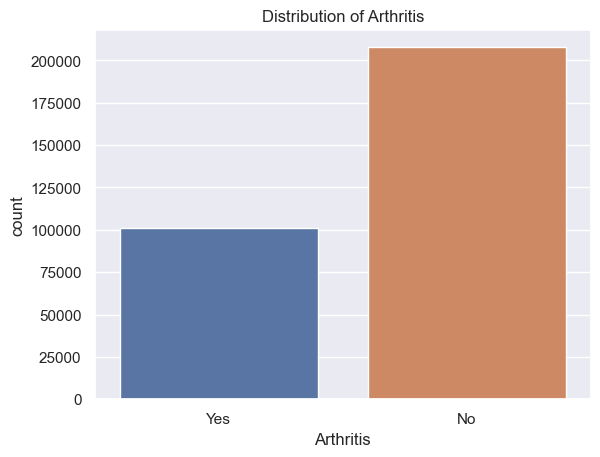

In [20]:
sns.countplot(x=data['Arthritis'])
plt.title('Distribution of Arthritis')

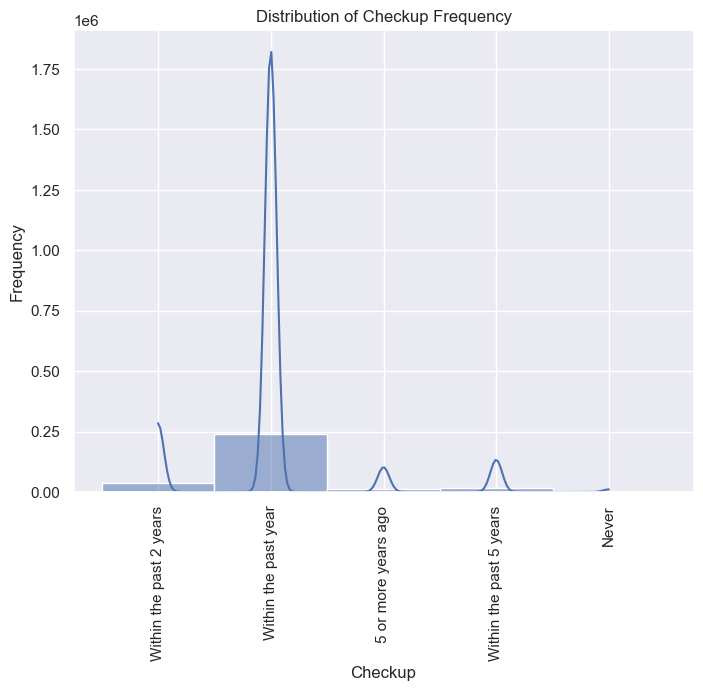

In [21]:
# Histogram for "Checkup"
plt.figure(figsize=(8, 6))
sns.histplot(data=data, x="Checkup", kde=True)
plt.xlabel("Checkup")
plt.ylabel("Frequency")
plt.title("Distribution of Checkup Frequency")
plt.xticks(rotation=90)
plt.show()

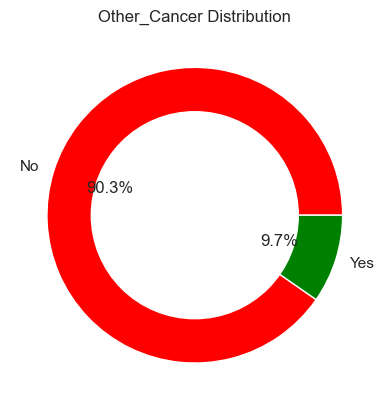

In [22]:
# Create a circle at the center of
# the plot
my_circle = plt.Circle((0, 0), 0.7, color='white')

binary_counts = data['Other_Cancer'].value_counts()
# Give color names
plt.pie(binary_counts, labels=binary_counts.index ,autopct='%1.1f%%',
        colors=['red', 'green'])

p = plt.gcf()
p.gca().add_artist(my_circle)

# Show the graph
plt.title('Other_Cancer Distribution')
plt.show()

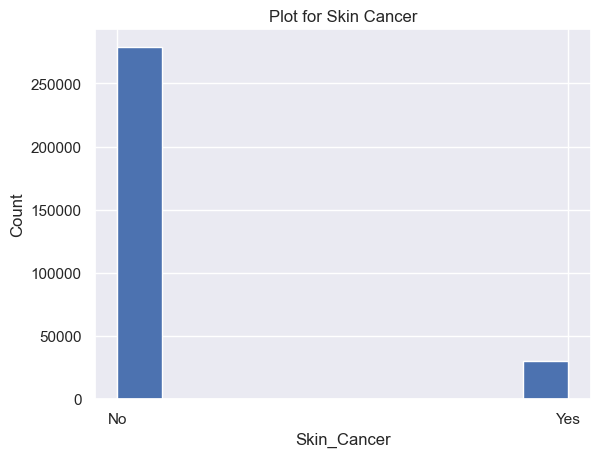

In [23]:
plt.hist(data['Skin_Cancer'])
plt.title('Plot for Skin Cancer')
plt.xlabel('Skin_Cancer')
plt.ylabel('Count')
plt.show()

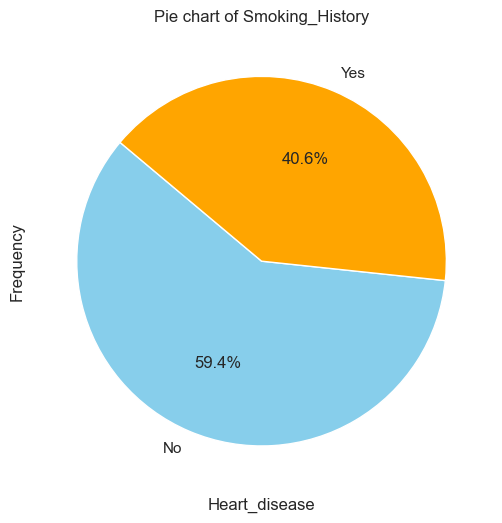

In [24]:
plt.figure(figsize=(10, 6))
binary_counts = data['Smoking_History'].value_counts()
plt.pie(binary_counts, labels=binary_counts.index, autopct='%1.1f%%', startangle=140, colors=['skyblue', 'orange'])
plt.title(f'Pie chart of Smoking_History')
plt.xlabel('Heart_disease')
plt.ylabel('Frequency')
plt.grid(True)
plt.show()

Text(0.5, 1.0, 'Plot for Diabetes')

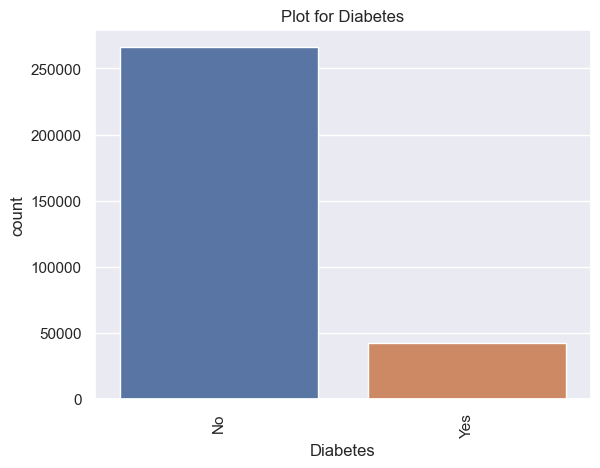

In [25]:
sns.countplot(x=data['Diabetes'])
plt.xticks(rotation=90)
plt.title(f'Plot for Diabetes')

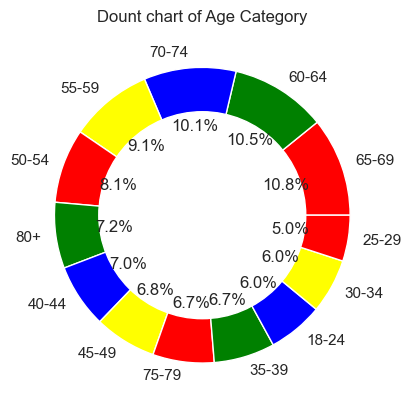

In [26]:
# Create a circle at the center of
# the plot
my_circle = plt.Circle((0, 0), 0.7, color='white')

binary_counts = data['Age_Category'].value_counts()
# Give color names
plt.pie(binary_counts, labels=binary_counts.index ,autopct='%1.1f%%',
        colors=['red', 'green', 'blue', 'yellow'])

p = plt.gcf()
p.gca().add_artist(my_circle)
plt.title(f'Dount chart of Age Category')
# Show the graph
plt.show()

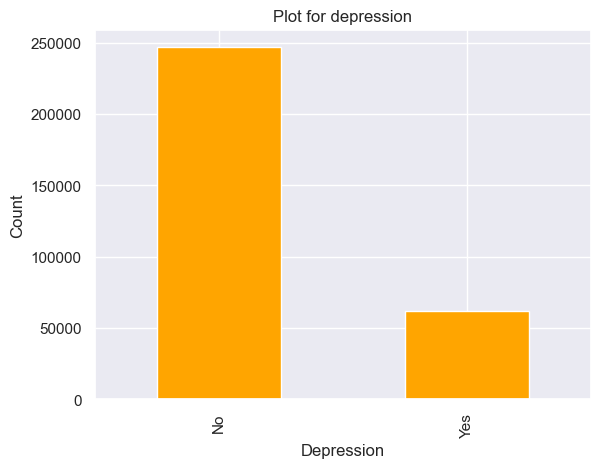

In [27]:
data['Depression'].value_counts().head(10).plot.bar(color='orange')
plt.title("Plot for depression")
plt.xlabel('Depression')
plt.ylabel('Count')
plt.show()

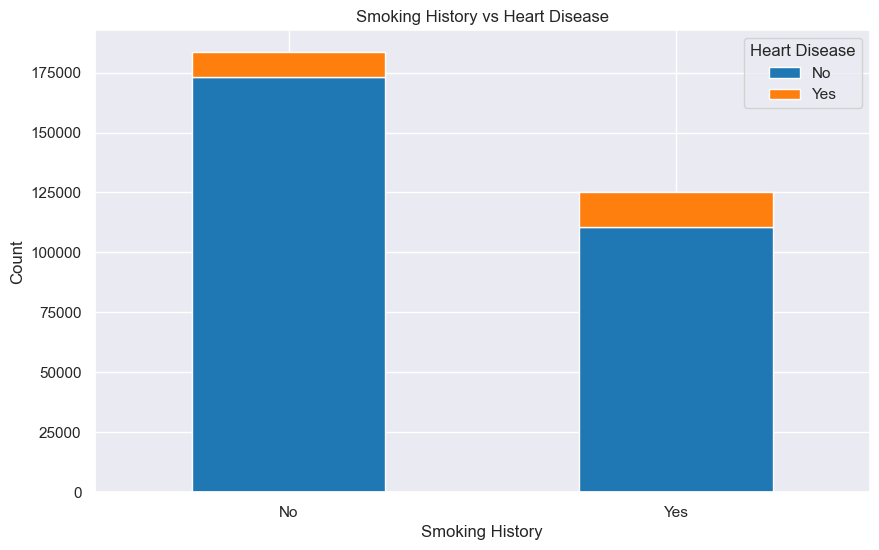

In [28]:
# Calculate the counts for each combination of Smoking_History and Heart_Disease
count_matrix = data.groupby(['Smoking_History', 'Heart_Disease']).size().unstack()

# Plot the segmented bar chart
count_matrix.plot(kind='bar', stacked=True, figsize=(10, 6), color=['#1f77b4', '#ff7f0e'])

# Set the title and labels
plt.title('Smoking History vs Heart Disease')
plt.xlabel('Smoking History')
plt.ylabel('Count')
plt.xticks(rotation=0)  # Rotate x-axis labels if needed

# Add legend
plt.legend(title='Heart Disease', labels=['No', 'Yes'])

# Show the plot
plt.show()


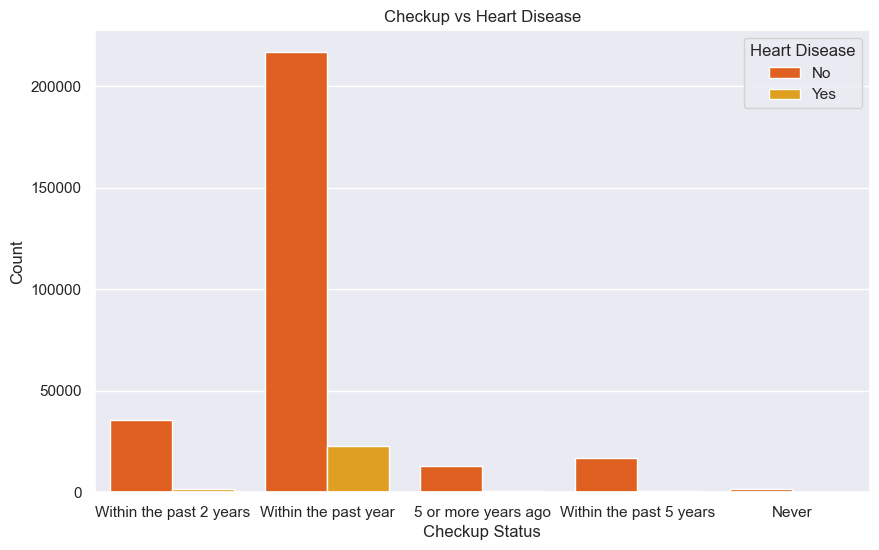

In [29]:
plt.figure(figsize=(10, 6))
sns.countplot(data=data, x='Checkup', hue='Heart_Disease', palette='autumn')
plt.title('Checkup vs Heart Disease')
plt.xlabel('Checkup Status')
plt.ylabel('Count')
plt.legend(title='Heart Disease', labels=['No', 'Yes'])
plt.show()


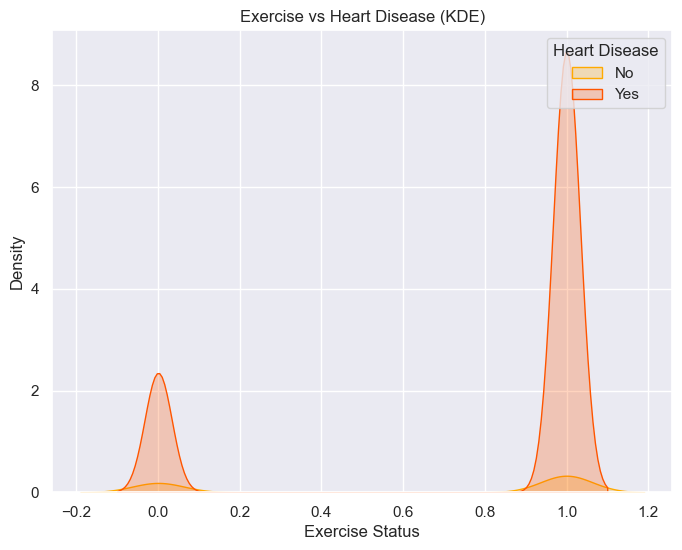

In [30]:
# Assuming 'Exercise' is a categorical variable
# Encode 'Exercise' into numeric labels
label_encoder = LabelEncoder()
data1=data.copy()
data1['Exercise'] = label_encoder.fit_transform(data1['Exercise'])

# Plot the KDE plot using the encoded column
plt.figure(figsize=(8, 6))
sns.kdeplot(data=data1, x='Exercise', hue='Heart_Disease', fill=True, palette='autumn')
plt.title('Exercise vs Heart Disease (KDE)')
plt.xlabel('Exercise Status')
plt.ylabel('Density')
plt.legend(title='Heart Disease', labels=['No', 'Yes'])
plt.show()


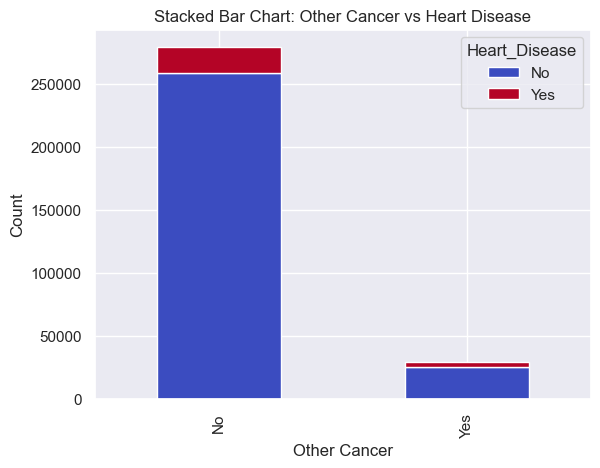

In [31]:
# Create a crosstab of Other_Cancer vs. Heart_Disease
crosstab = pd.crosstab(data['Other_Cancer'], data['Heart_Disease'])

# Plot the stacked bar chart
crosstab.plot(kind='bar', stacked=True, colormap='coolwarm')

# Set the title and labels
plt.title('Stacked Bar Chart: Other Cancer vs Heart Disease')
plt.xlabel('Other Cancer')
plt.ylabel('Count')

# Show the plot
plt.show()

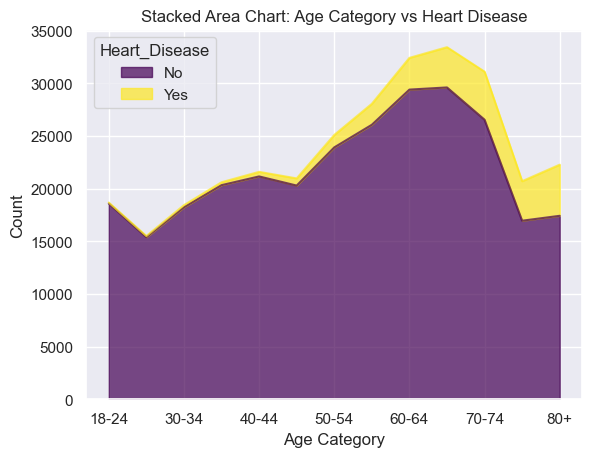

In [32]:
# Create a crosstab of Age_Category vs. Heart_Disease
crosstab = pd.crosstab(data['Age_Category'], data['Heart_Disease'])

# Plot the stacked area chart
crosstab.plot(kind='area', colormap='viridis', alpha=0.7, stacked=True)

# Set the title and labels
plt.title('Stacked Area Chart: Age Category vs Heart Disease')
plt.xlabel('Age Category')
plt.ylabel('Count')

# Show the plot
plt.show()

Text(0.5, 1.0, 'Depression vs. Heart Disease')

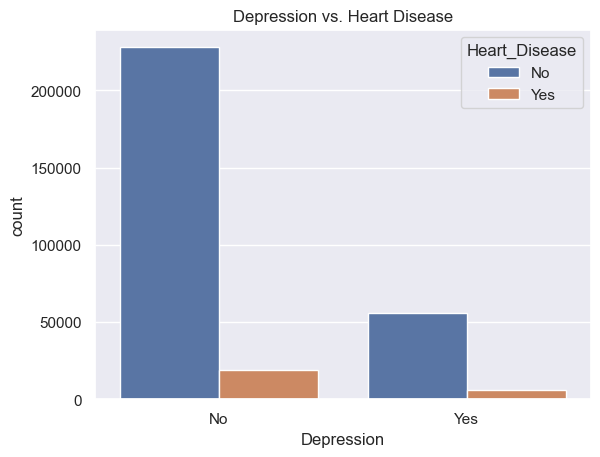

In [33]:
sns.countplot(x=data['Depression'], hue=data['Heart_Disease'])
plt.title('Depression vs. Heart Disease')

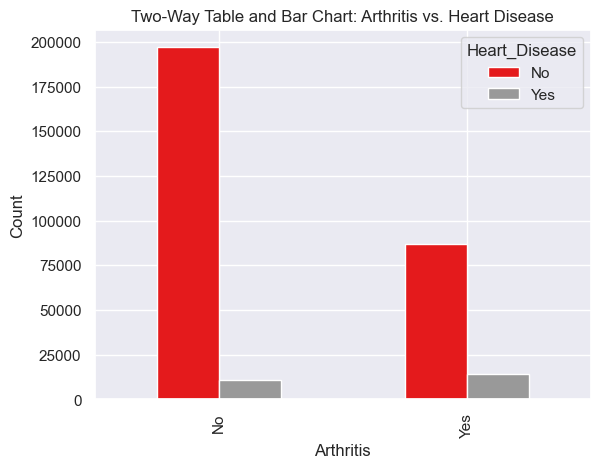

In [34]:
# Create a two-way table (contingency table) for Arthritis vs. Heart Disease
table = pd.crosstab(data['Arthritis'], data['Heart_Disease'])

# Plot the bar chart
table.plot(kind='bar', colormap='Set1')
plt.title('Two-Way Table and Bar Chart: Arthritis vs. Heart Disease')
plt.xlabel('Arthritis')
plt.ylabel('Count')
plt.show()

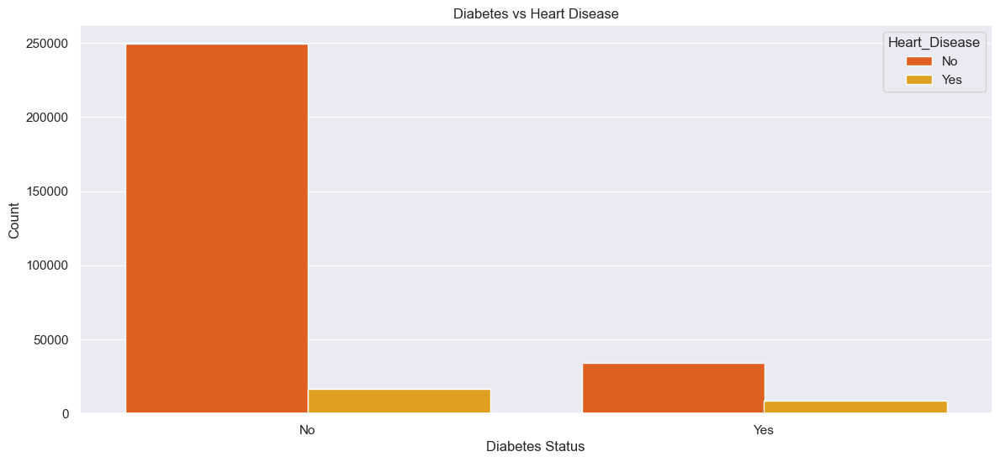

In [35]:
plt.figure(figsize=(14, 6))
sns.countplot(data=data, x='Diabetes', hue='Heart_Disease', palette='autumn')
plt.title('Diabetes vs Heart Disease')
plt.xlabel('Diabetes Status')
plt.ylabel('Count')
plt.show()

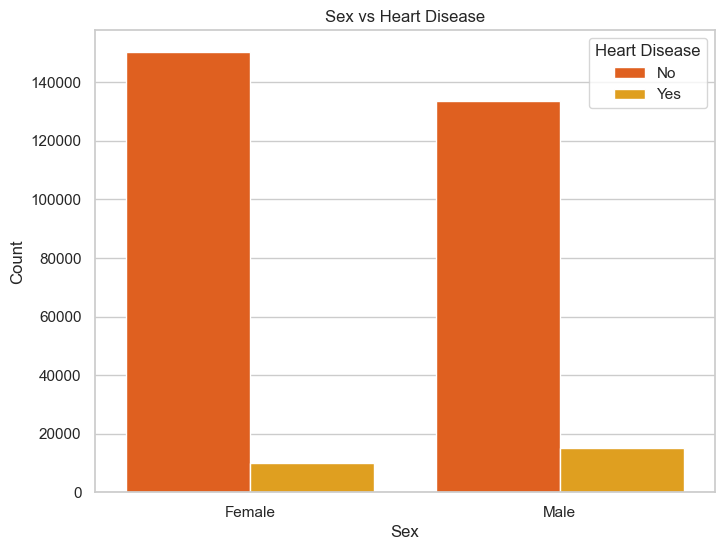

In [36]:
# Set the style of seaborn
sns.set_style("whitegrid")

# Create the bar plot
plt.figure(figsize=(8, 6))
sns.countplot(data=data, x='Sex', hue='Heart_Disease', palette='autumn')
plt.title('Sex vs Heart Disease')
plt.xlabel('Sex')
plt.ylabel('Count')
plt.legend(title='Heart Disease', labels=['No', 'Yes'])
plt.show()

In [37]:
# Define color sequence for the histogram bars
color = ['blue', 'red']  # Example colors

# Create the histogram figure for numeric columns
fig1 = px.histogram(data, x="Sex", color='Heart_Disease', barmode='group', color_discrete_sequence=color,
                    title="Checking which gender is more susceptible to Heart Disease?",
                    labels={'Heart_Disease': 'Gender'},
                    category_orders={"Sex": ["Female", "Male"]})  # Specify category order
# Update the legend labels
fig1.for_each_trace(lambda t: t.update(name="Female" if t.name == "0" else "Male"))  # Update legend labels

# Show the histogram figure
#fig1.show()

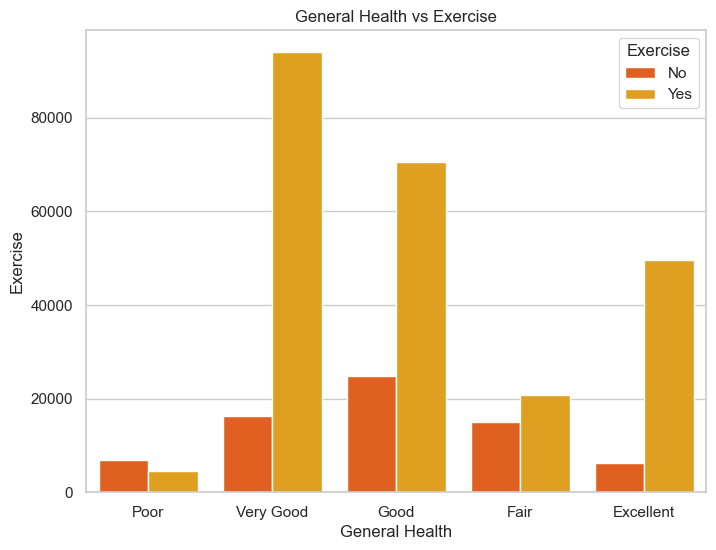

In [38]:
plt.figure(figsize=(8, 6))
sns.countplot(data=data, x='General_Health', hue='Exercise', palette='autumn')
plt.title('General Health vs Exercise')
plt.xlabel('General Health')
plt.ylabel('Exercise')
plt.show()

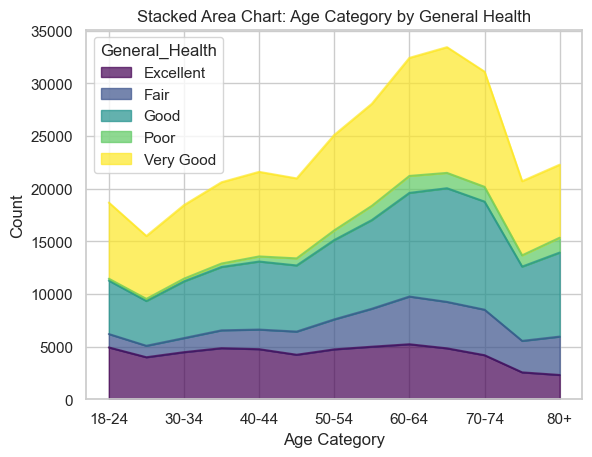

In [39]:
#Stacked Area Chart Age_Category by General_Health.
crosstab = pd.crosstab(data['Age_Category'], data['General_Health'])
crosstab.plot(kind='area', colormap='viridis', alpha=0.7, stacked=True)
plt.title('Stacked Area Chart: Age Category by General Health')
plt.xlabel('Age Category')
plt.ylabel('Count')
plt.show()

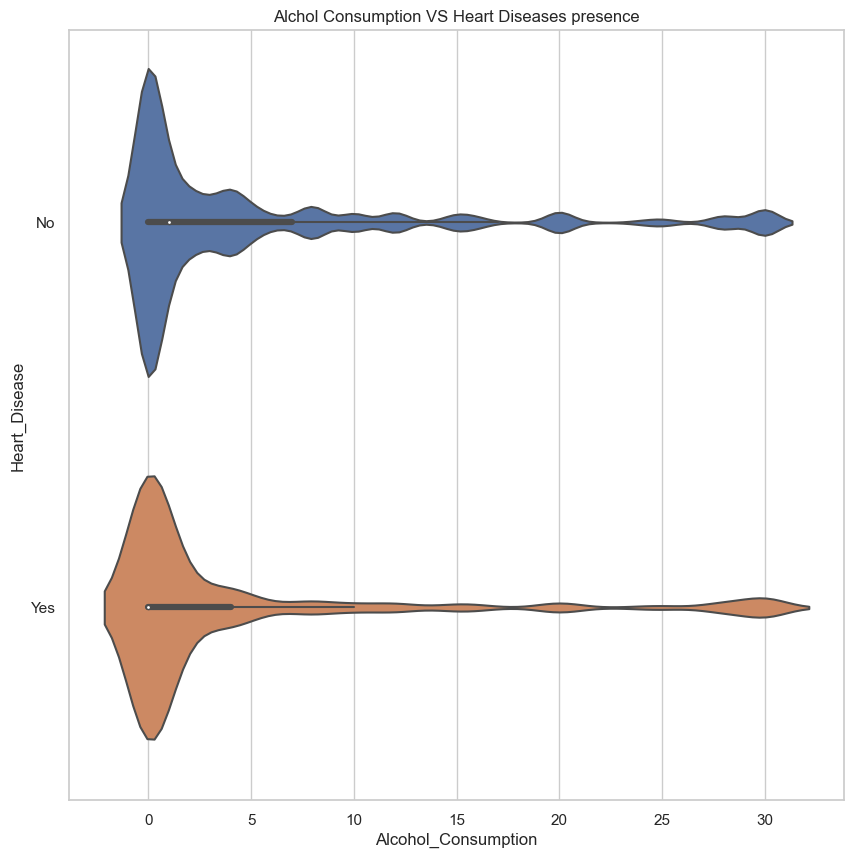

In [40]:
plt.figure(figsize=(10,10))
sns.violinplot(x=data['Alcohol_Consumption'], y=data['Heart_Disease'],data=data)
plt.title("Alchol Consumption VS Heart Diseases presence")
plt.show()


Text(0.5, 1.0, 'Fruit_Consumption VS Heart Diseases presence')

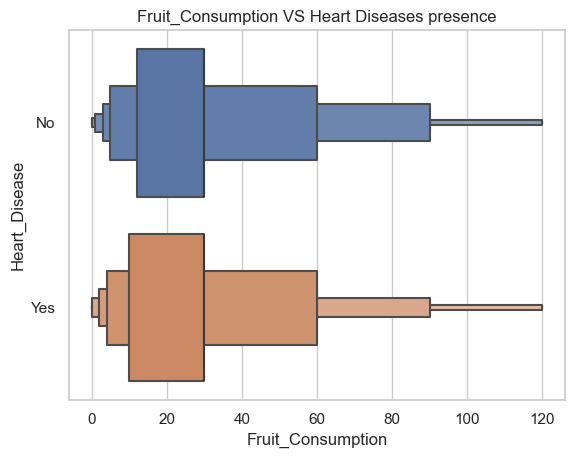

In [41]:
sns.boxenplot(x=data['Fruit_Consumption'], y=data['Heart_Disease'],data=data)
plt.title("Fruit_Consumption VS Heart Diseases presence")

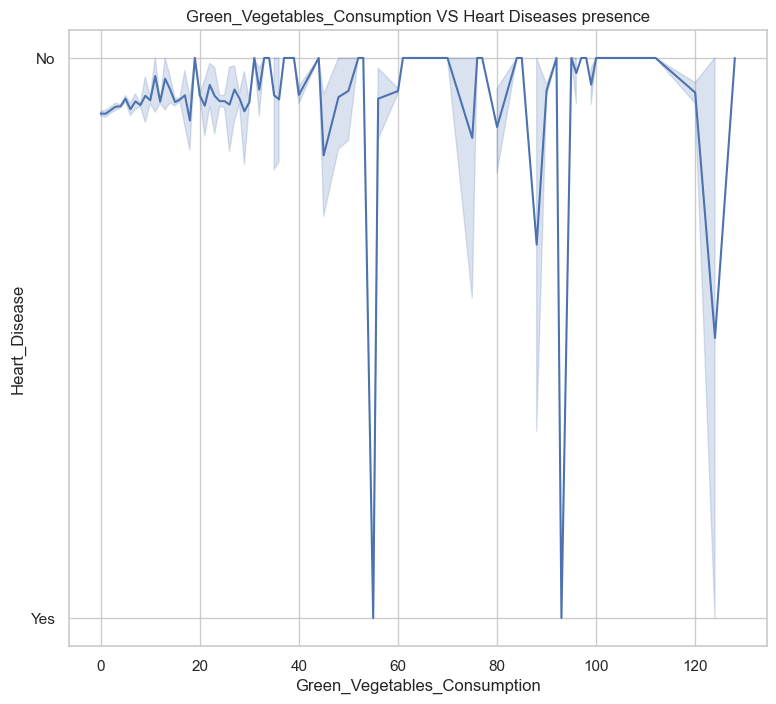

In [42]:
plt.figure(figsize=(9,8))
sns.lineplot(x=data['Green_Vegetables_Consumption'],y=data['Heart_Disease'],data=data)
plt.title("Green_Vegetables_Consumption VS Heart Diseases presence")
plt.show()

Text(0.5, 1.0, 'BMI VS Heart Diseases presence')

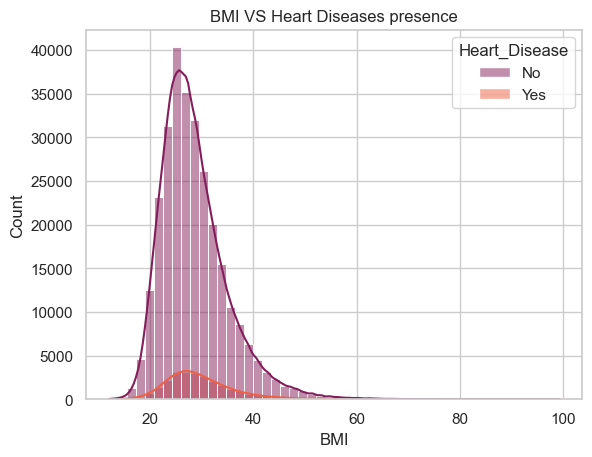

In [43]:
sns.histplot(data = data,x=data['BMI'],hue=data['Heart_Disease'],
                                bins=50,kde=True,palette='rocket')
plt.title("BMI VS Heart Diseases presence")

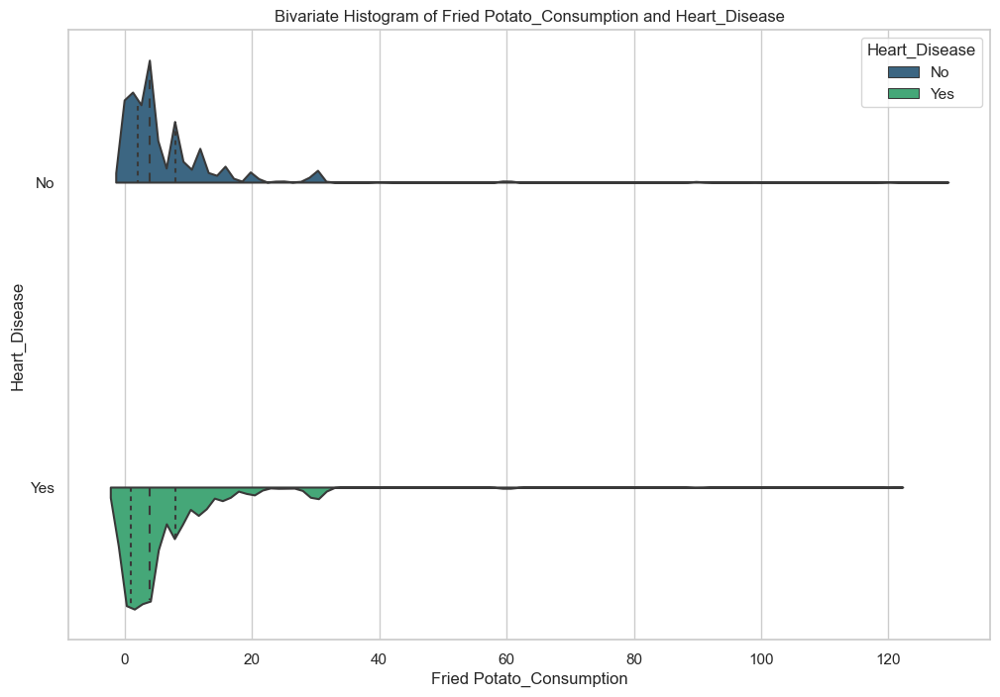

In [44]:
plt.figure(figsize=(12, 8))
sns.violinplot(x=data['FriedPotato_Consumption'], y=data['Heart_Disease'], hue=data['Heart_Disease'], split=True, inner="quart", palette="viridis")
plt.title(f'Bivariate Histogram of Fried Potato_Consumption and Heart_Disease')
plt.xlabel('Fried Potato_Consumption')
plt.ylabel('Heart_Disease')

plt.show()

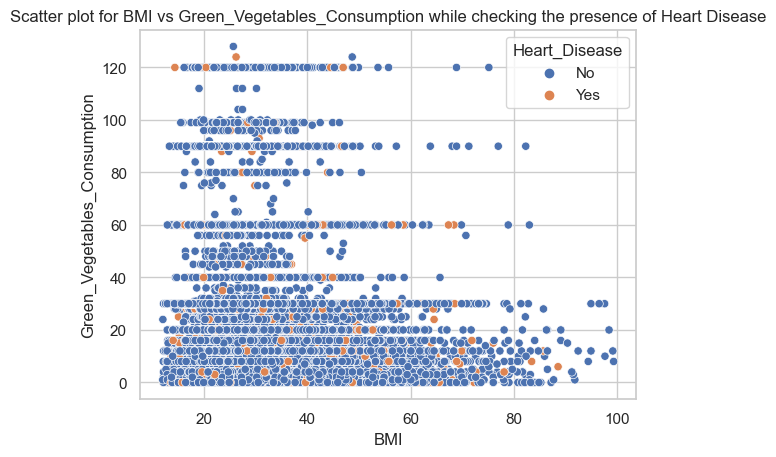

In [45]:
sns.scatterplot(data = data ,x = 'BMI',y = 'Green_Vegetables_Consumption', hue = 'Heart_Disease')
plt.title("Scatter plot for BMI vs Green_Vegetables_Consumption while checking the presence of Heart Disease")
plt.show()

In [46]:
def categorize_age(age):
    if age in ['18-24']:
        return 'Young'
    if age in ['25-29', '30-34', '35-39']:
        return 'Adult'
    elif age in ['40-44', '45-49', '50-54']:
        return 'Mid-Aged'
    elif age in ['55-59', '60-64','65-69']:
        return 'Senior-Adult'
    elif age in ['70-74', '75-79','80+']:
        return 'Elderly'
# Apply the function to the Age_Category column
data['Age_Group'] = data['Age_Category'].apply(categorize_age)

# Create a mapping from Age_Group to its combined string of name and range
age_mapping = {
    'Young': 'Young (18-24)',
    'Adult': 'Adult (25-39)',
    'Mid-Aged': 'Mid-Aged (40-54)',
    'Senior-Adult': 'Senior-Adult (55-69)',
    'Elderly': 'Elderly (70+)'
}

# Map the Age_Group to its detailed label
data['Age_Label'] = data['Age_Group'].map(age_mapping)

# Create a box plot visualizing BMI across age details and colored by heart disease status
fig = px.box(data,
             x="Age_Label",
             y="BMI",
             color="Heart_Disease",
             title="BMI Distribution across Age Groups based on Heart Disease Status",
             category_orders={"Age_Label": list(age_mapping.values())})

# Display the plot
fig.show()

In [47]:
data=data.drop("Age_Label",axis=1)
data=data.drop("Age_Group",axis=1)

In [48]:
plt.figure(figsize=(10, 14))
fig = px.sunburst(data, path=['Sex','Heart_Disease' ,'Age_Category'],values='Alcohol_Consumption', color='Alcohol_Consumption',title='Analysis of Sex, Age category and the presence of heart disease ')
fig.show()

<Figure size 1000x1400 with 0 Axes>

In [49]:
num_cols = ['Height_(cm)', 'Weight_(kg)', 'BMI', 'Alcohol_Consumption', 'Fruit_Consumption', 'Green_Vegetables_Consumption', 'FriedPotato_Consumption']
cat_cols = ['General_Health', 'Checkup', 'Exercise', 'Heart_Disease','Sex' ,'Skin_Cancer', 'Other_Cancer', 'Depression', 'Diabetes', 'Arthritis', 'Age_Category', 'Smoking_History']
enc = OrdinalEncoder()
encoded_cat_data = pd.DataFrame(enc.fit_transform(data[cat_cols]), columns=cat_cols)
data_new = pd.concat([data[num_cols], encoded_cat_data], axis=1)

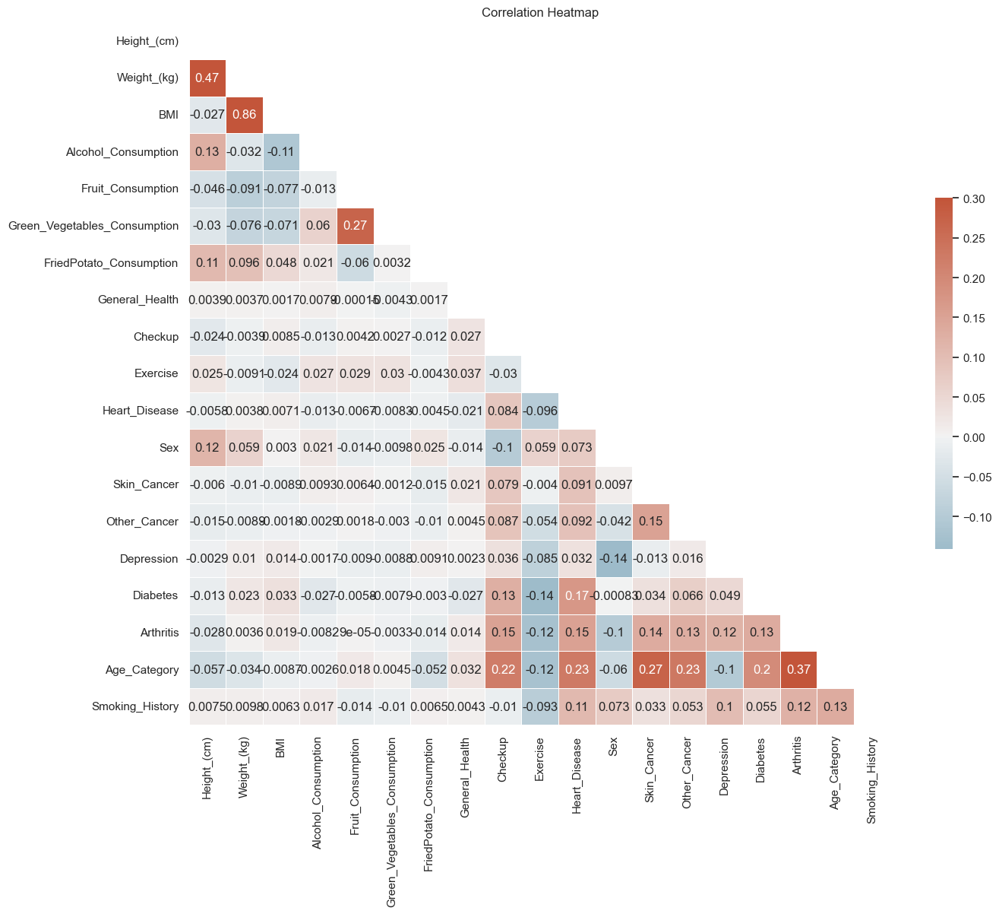

In [50]:
# Compute the correlation matrix
corr = data_new.corr()

# Generate a mask for the upper triangle
mask = np.triu(np.ones_like(corr, dtype=bool))

# Set up the matplotlib figure
plt.figure(figsize=(15, 12))

# Generate a custom diverging colormap
cmap = sns.diverging_palette(230, 20, as_cmap=True)

# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(corr, mask=mask, cmap=cmap, vmax=.3, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5}, annot=True)

plt.title('Correlation Heatmap')
plt.show()

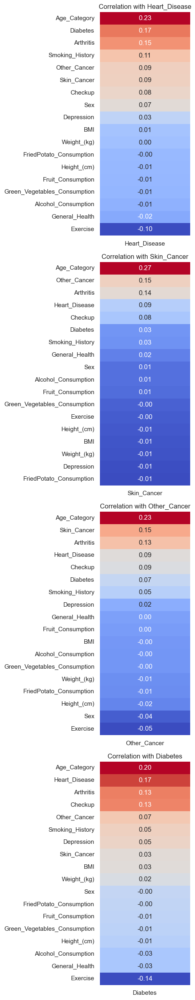

In [51]:
# Compute the correlation of each feature with the disease variables
disease_variables = ['Heart_Disease', 'Skin_Cancer', 'Other_Cancer', 'Diabetes']

# Compute the correlation matrix
corr = data_new.corr()

# Create a subplot for each disease
fig, axs = plt.subplots(len(disease_variables), 1, figsize=(5, 25))

for ax, disease in zip(axs, disease_variables):
    # Compute the correlation with the disease
    target_corr = corr[disease].drop(disease)

    # Sort correlation values in descending order
    target_corr_sorted = target_corr.sort_values(ascending=False)

    # Plot a heatmap of the correlations with the disease
    sns.heatmap(target_corr_sorted.to_frame(), cmap="coolwarm", annot=True, fmt='.2f', cbar=False, ax=ax)
    ax.set_title('Correlation with ' + disease)

plt.tight_layout()
plt.show()

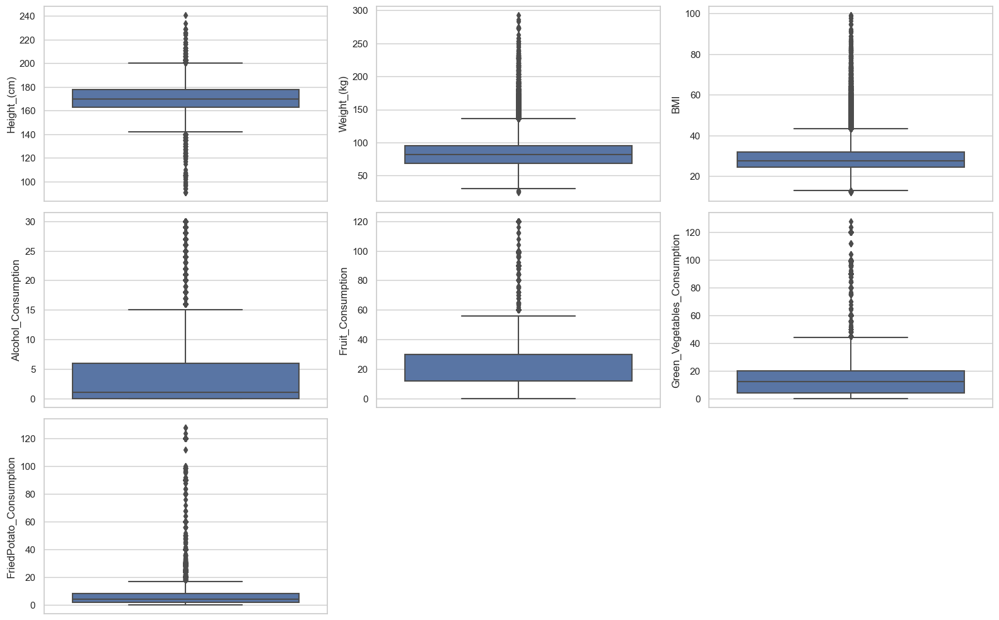

In [52]:
# List of numerical columns
numerical_cols = ['Height_(cm)', 'Weight_(kg)', 'BMI', 'Alcohol_Consumption',
                  'Fruit_Consumption', 'Green_Vegetables_Consumption',
                  'FriedPotato_Consumption']

# Create box plots
plt.figure(figsize=(16, 10))
for i, column in enumerate(numerical_cols, 1):
    plt.subplot(3, 3, i)
    sns.boxplot(y=data[column])

plt.tight_layout()

In [53]:
#Looping through categorical features and saving it to a dictionary
categorical = data.select_dtypes(include=['object']).columns
numerical = data.select_dtypes(include=['float64']).columns
unique_categories_dict = {}
for col in categorical:
  unique_categories_dict[col] = data[col].unique().tolist()

l=[]
for i in unique_categories_dict.values():
  l.append(i)
#Applying ordinal encoding to categorical features
ordinal_encoder = OrdinalEncoder(categories=l)
data[categorical]=ordinal_encoder.fit_transform(data[categorical])

In [54]:
data.head()

,General_Health,Checkup,Exercise,Heart_Disease,Skin_Cancer,Other_Cancer,Depression,Diabetes,Arthritis,Sex,Age_Category,Height_(cm),Weight_(kg),BMI,Smoking_History,Alcohol_Consumption,Fruit_Consumption,Green_Vegetables_Consumption,FriedPotato_Consumption
0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,150.0,32.66,14.54,0.0,0.0,30.0,16.0,12.0
1,1.0,1.0,0.0,1.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,165.0,77.11,28.29,1.0,0.0,30.0,0.0,4.0
2,1.0,1.0,1.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,1.0,163.0,88.45,33.47,1.0,4.0,12.0,3.0,16.0
3,0.0,1.0,1.0,1.0,0.0,0.0,0.0,1.0,1.0,1.0,2.0,180.0,93.44,28.73,1.0,0.0,30.0,30.0,8.0
4,2.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,3.0,191.0,88.45,24.37,0.0,0.0,8.0,4.0,0.0


In [55]:
#Oversampling using SMOTE
X = data.drop('Heart_Disease', axis='columns')
y = data['Heart_Disease']
sm = SMOTE(random_state=5)
X_bal, y_bal = sm.fit_resample(X, y)
X_train, X_test, y_train, y_test = train_test_split(X_bal, y_bal, test_size=0.3, random_state=22)

In [56]:
lr = LogisticRegression(max_iter=10000,random_state=22)
lr.fit(X_train, y_train)
lr_pred = lr.predict(X_test)
lr_pred_prob = lr.predict_proba(X_test)
print("Classification Report for Logistic Regression\n",classification_report(y_test, lr_pred))
print('\n')
print("The ROC AUC Score is\n",roc_auc_score(y_test, lr_pred_prob[:,1]))

Classification Report for Logistic Regression
               precision    recall  f1-score   support

         0.0       0.74      0.71      0.73     85002
         1.0       0.72      0.75      0.74     85280

    accuracy                           0.73    170282
   macro avg       0.73      0.73      0.73    170282
weighted avg       0.73      0.73      0.73    170282



The ROC AUC Score is
 0.8017250432177228


In [57]:
rcf = RandomForestClassifier(n_estimators=100,random_state=22)
rcf.fit(X_train, y_train)
rcf_pred = rcf.predict(X_test)
rcf_pred_prob = rcf.predict_proba(X_test)
print("Classification Report for Random Forest Classifier\n",classification_report(y_test, rcf_pred))
print('\n')
print("The ROC AUC Score is\n",roc_auc_score(y_test, rcf_pred_prob[:,1]))

Classification Report for Random Forest Classifier
               precision    recall  f1-score   support

         0.0       0.92      0.99      0.96     85002
         1.0       0.99      0.92      0.95     85280

    accuracy                           0.96    170282
   macro avg       0.96      0.96      0.96    170282
weighted avg       0.96      0.96      0.96    170282



The ROC AUC Score is
 0.9846959472270226


In [58]:
dct = DecisionTreeClassifier(random_state=22)
dct.fit(X_train, y_train)
dct_pred = dct.predict(X_test)
dct_pred_prob = dct.predict_proba(X_test)
print("Classification Report for Decision Tree Classifier\n",classification_report(y_test, dct_pred))
print('\n')
print("The ROC AUC Score is\n",roc_auc_score(y_test, dct_pred_prob[:,1]))

Classification Report for Decision Tree Classifier
               precision    recall  f1-score   support

         0.0       0.93      0.91      0.92     85002
         1.0       0.92      0.93      0.92     85280

    accuracy                           0.92    170282
   macro avg       0.92      0.92      0.92    170282
weighted avg       0.92      0.92      0.92    170282



The ROC AUC Score is
 0.9232367844655724


In [59]:
xgb = XGBClassifier()
xgb.fit(X_train, y_train)
xgb_pred = xgb.predict(X_test)
xgb_pred_prob = xgb.predict_proba(X_test)
print("Classification Report for XGBoost Classifier\n",classification_report(y_test, xgb_pred))
print('\n')
print("The ROC AUC Score is\n",roc_auc_score(y_test, xgb_pred_prob[:,1]))

Classification Report for XGBoost Classifier
               precision    recall  f1-score   support

         0.0       0.92      0.99      0.96     85002
         1.0       0.99      0.91      0.95     85280

    accuracy                           0.95    170282
   macro avg       0.96      0.95      0.95    170282
weighted avg       0.96      0.95      0.95    170282



The ROC AUC Score is
 0.9849202774248815


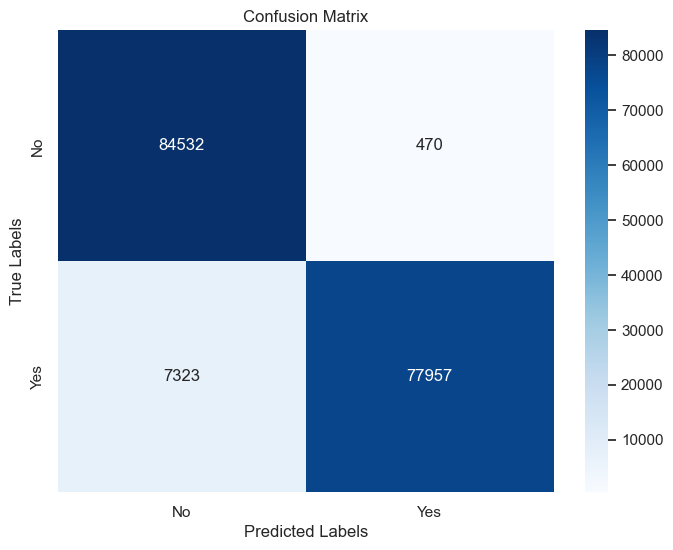

In [60]:
#Confusion matrix
cmat=confusion_matrix(y_test,xgb_pred)
plt.figure(figsize=(8, 6))
classlabels=["No","Yes"]
sns.heatmap(cmat, annot=True, cmap='Blues', fmt='d',
            xticklabels=classlabels, yticklabels=classlabels)
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.title('Confusion Matrix')
plt.show()

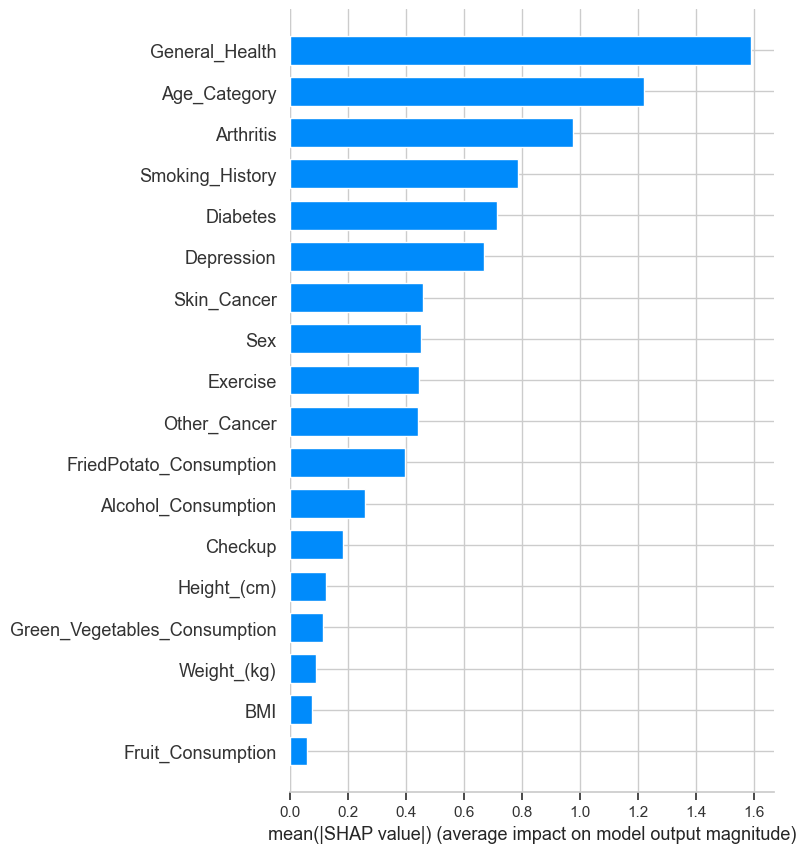

In [61]:
#SHAP integration and displaying summary plot
explainer = shap.TreeExplainer(xgb)
shap_values = explainer.shap_values(X_test)
shap.summary_plot(shap_values, X_test,plot_type="bar")

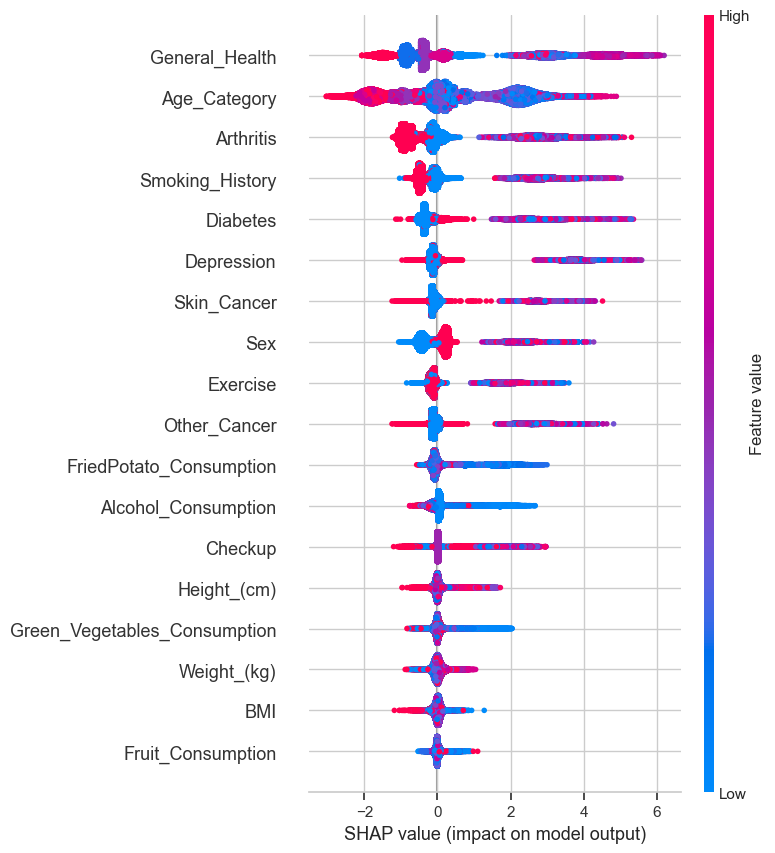

In [62]:
shap.initjs()
shap.summary_plot(shap_values, X_test)

In [68]:
#Dumping the model
dump(xgb, 'model.joblib')

['model.joblib']